# **Digital Image Processing**

Various kinds of image processing functions and their examples can be found here.

***List of functions:***
+ [Image Basics](#image-basics "Image Basics")
  - `download_image(file_name, image_url)`
  - `get_image(file_name)`
  - `show_image(img)`
  - `get_image_dimensions(img)`
+ [Grayscale Conversion](#grayscale "Grayscale Conversion")
  - `get_image_channels(img)`
  - `get_3D_grayscale(img)`
  - `get_grayscale(img)`
+ [Noise Addition](#add-noise "Noise Addition")
  - `get_noisy_image(img, percentage, noise_value_function)`
  - `add_salt_noise(img, percentage=10)`
  - `add_pepper_noise(img, percentage=10)`
  - `add_salt_and_pepper_noise(img, percentage=10)`
+ [Noise Removal](#remove-noise "Noise Removal")
  - `noise_removal_by_averaging(img_count, noise_function)`
+ [Image Color Channels](#color-channels "Image Color Channels")
  - `show_channel(img, pos, mode)`
  - [RGB (Red, Green, Blue)](#rgb "RGB (Red, Green, Blue)")
    * `show_red_channel(img)`
    * `show_green_channel(img)`
    * `show_blue_channel(img)`
  - [CMY (Cyan, Magenta, Yellow)](#cmy "CMY (Cyan, Magenta, Yellow)")
    * `show_cyan_channel(img)`
    * `show_magenta_channel(img)`
    * `show_yellow_channel(img)`
+ [Image Convolution](#convolution "Image Convolution")
  - `get_padded_image(img, no_of_padding, padding_value=0)`
  - `convolve_2D(img, filter, padding=0, stride=1)`
  - `convolve(img, filter, padding=0, stride=1)`
+ [Laplacian Sharpening](#laplace-sharp "Laplacian Sharpening")
  - `get_laplacian_filter(mode='POS8')`
  - `laplacian_sharpen(img, laplacian_filter_type='POS8', multiplier=1)`
+ [Image Equalization](https://)

In [1]:
import math
import random
import requests
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

In [ ]:
# https://cdn.stocksnap.io/img-thumbs/960w/vegan-pasta_KRX6BEOKGM.jpg

### **Utility Functions for Speed**

In [2]:
def round_to_int(num):
  return int(num + 0.5)

<a name="image-basics"></a>
## **Image Basics**

In [3]:
def download_image(file_name, image_url):
  img_data = requests.get(image_url).content

  with open(file_name, 'wb') as handler:
    handler.write(img_data) 

In [4]:
file_name = 'vegan-pasta.jpg'
image_url = 'https://cdn.stocksnap.io/img-thumbs/960w/vegan-pasta_KRX6BEOKGM.jpg'

download_image(file_name, image_url)

In [5]:
def get_image(file_name):
  return cv2.imread(file_name)


def show_image(img):
  try:
    import google.colab
    IN_COLAB = True
  except:
    IN_COLAB = False

  if IN_COLAB:
    cv2_imshow(img)
  else:
    cv2.imshow(img)


def get_image_dimensions(img):
  dims = ()
  if hasattr(img, 'shape'):
    dims = img.shape
  else:
    raise Exception('Object is not an numpy ndarray. Image object must be represented as numpy ndarray')

  if len(dims) < 2:
    raise Exception('Invalid object passed. Object has incorrect dimensions for image.')
  
  return len(dims), dims

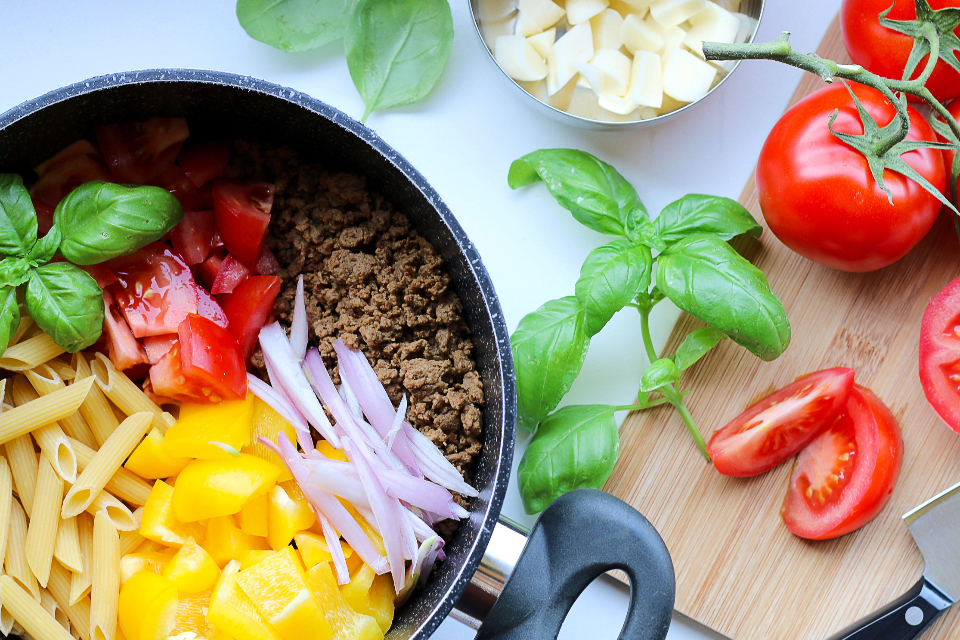

In [6]:
img = get_image(file_name)
show_image(img)

<a name="grayscale"></a>
## **Grayscale Conversion**

In [7]:
def get_image_channels(img):
  n, dims = get_image_dimensions(img)
  if n == 2:
    print('Given object has only one channel.')
    return None

  x, y, z = dims[0], dims[1], dims[2]
  channels = []

  for k in range(z):
    channels.append([])
    for i in range(x):
      channels[k].append([])

  for i in range(x):
    for j in range(y):
      for k in range(z):
        channels[k][i].append(img[i][j][k])
  
  return channels


def get_3D_grayscale(img):
  n, dims = get_image_dimensions(img)
  if n == 2:
    print('WARNING: given image is already 2D grayscale.')
    return img 

  x, y, z = dims[0], dims[1], dims[2]
  cimg = img.copy()

  for i in range(x):
    for j in range(y):
      values = cimg[i][j]
      cimg[i][j] = int(sum(values)/len(values) + 0.5) # rounding the value
  
  return cimg


def get_grayscale(img):
  channels = get_image_channels(img)

  cimg = (
            np.array(channels[0])/3 + 
            np.array(channels[1])/3 + 
            np.array(channels[2])/3
          )
  
  return cimg

In [8]:
bw_img = get_grayscale(img)
bw_3D_img = get_3D_grayscale(img)

print('get_grayscale() vs. get_3D_grayscale -->', bw_img.shape, ',', bw_3D_img.shape)

get_grayscale() vs. get_3D_grayscale --> (640, 960) , (640, 960, 3)


<a name="add-noise"></a>
## **Noise Addition**

In [9]:
def get_noisy_image(img, percentage, noise_value_function):
  n, dims = get_image_dimensions(img)
  x, y = dims[0], dims[1]

  cimg = img.copy()
  bits = 7
  check = round_to_int(((100 - percentage)<<bits)/100)

  if callable(noise_value_function):
    for i in range(x):
      for j in range(y):
        n = random.getrandbits(bits)
        if n > check:
          cimg[i][j] = noise_value_function()
  else:
    for i in range(x):
      for j in range(y):
        n = random.getrandbits(bits)
        if n > check:
          cimg[i][j] = noise_value_function

  return cimg


def add_salt_noise(img, percentage=10):
  noise_value_function = 255
  return get_noisy_image(img, percentage, noise_value_function)


def add_pepper_noise(img, percentage=10):
  noise_value_function = 0
  return get_noisy_image(img, percentage, noise_value_function)


def add_salt_and_pepper_noise(img, percentage=10):
  def noise_value_function():
    return random.getrandbits(8)

  return get_noisy_image(img, percentage, noise_value_function)  

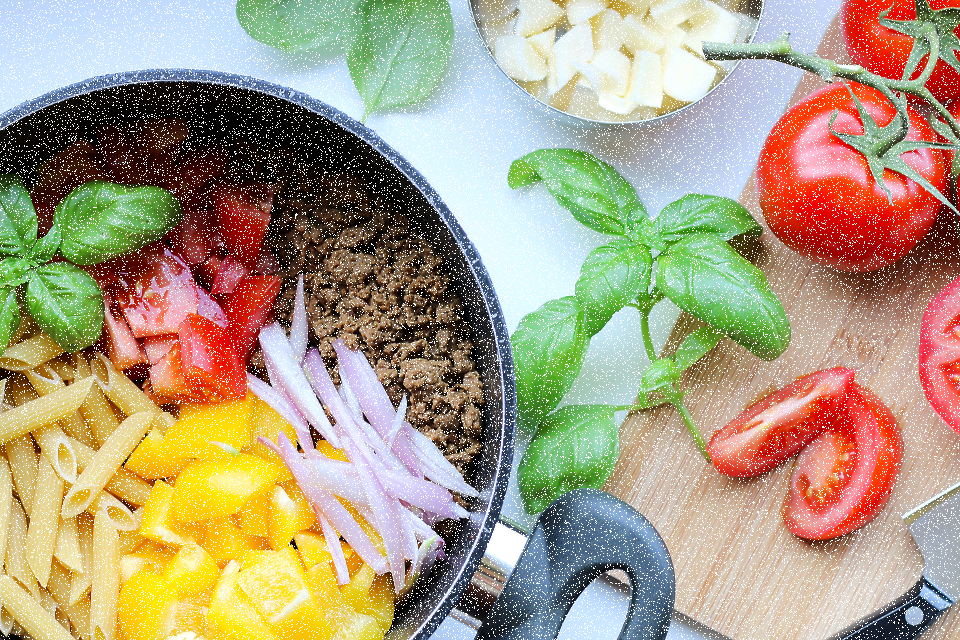

In [10]:
salt = add_salt_noise(img)

show_image(salt)

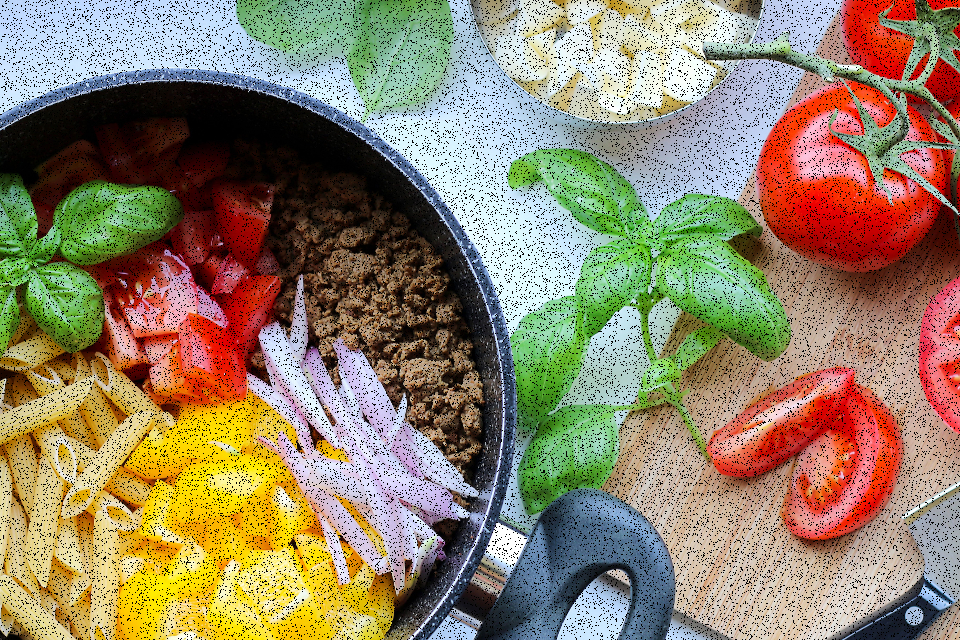

In [11]:
pepper = add_pepper_noise(img)

show_image(pepper)

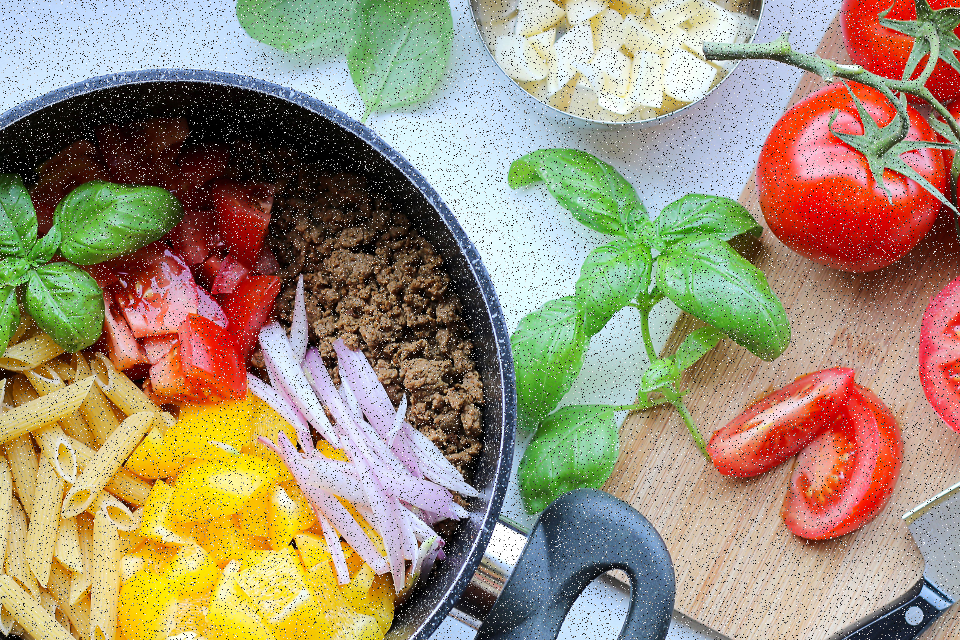

In [12]:
salt_pepper = add_salt_and_pepper_noise(img)

show_image(salt_pepper)

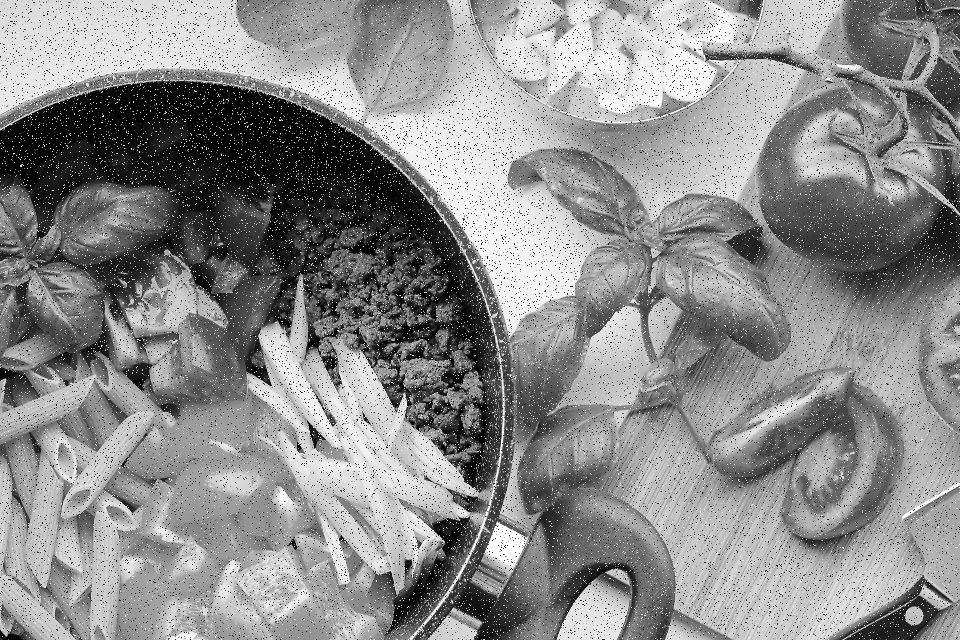

In [13]:
bw_salt_and_pepper = add_salt_and_pepper_noise(get_grayscale(img))

show_image(bw_salt_and_pepper)

<a name="remove-noise"></a>
## **Noise Removal**

In [14]:
def noise_removal_by_averaging(img_count, noise_function):
  noisy_images = [noise_function(img) for i in range(img_count)]
  
  noisy_images = [i/len(noisy_images) for i in noisy_images]
  avg_noisy_img = sum(noisy_images)

  show_image(avg_noisy_img)

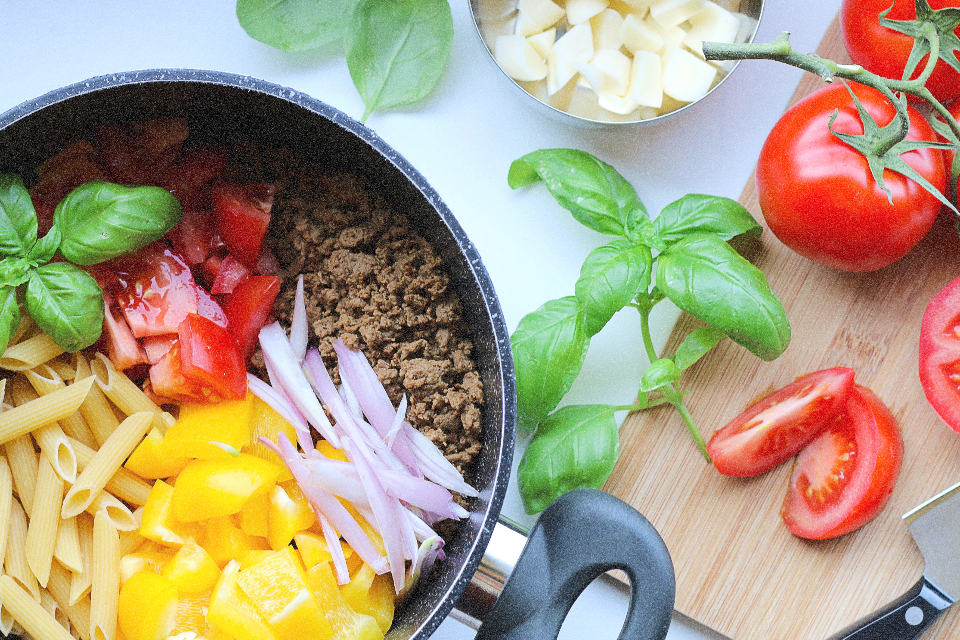

In [15]:
noise_removal_by_averaging(20, add_salt_noise)

# CONCLUSION: it works!

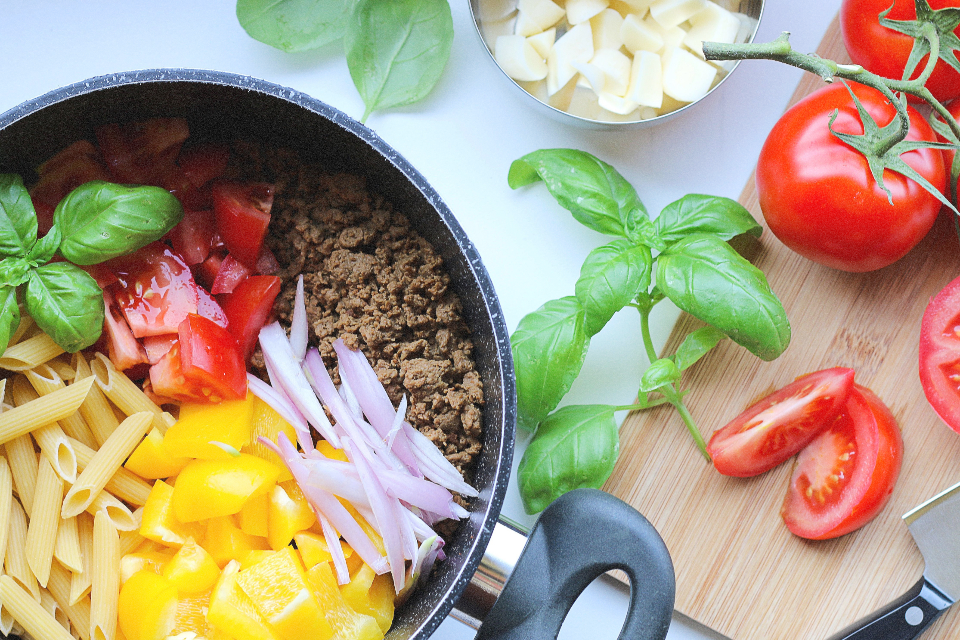

In [16]:
noise_removal_by_averaging(100, add_salt_noise)

# NOTICE: the more images there are, the less noisy the average is.

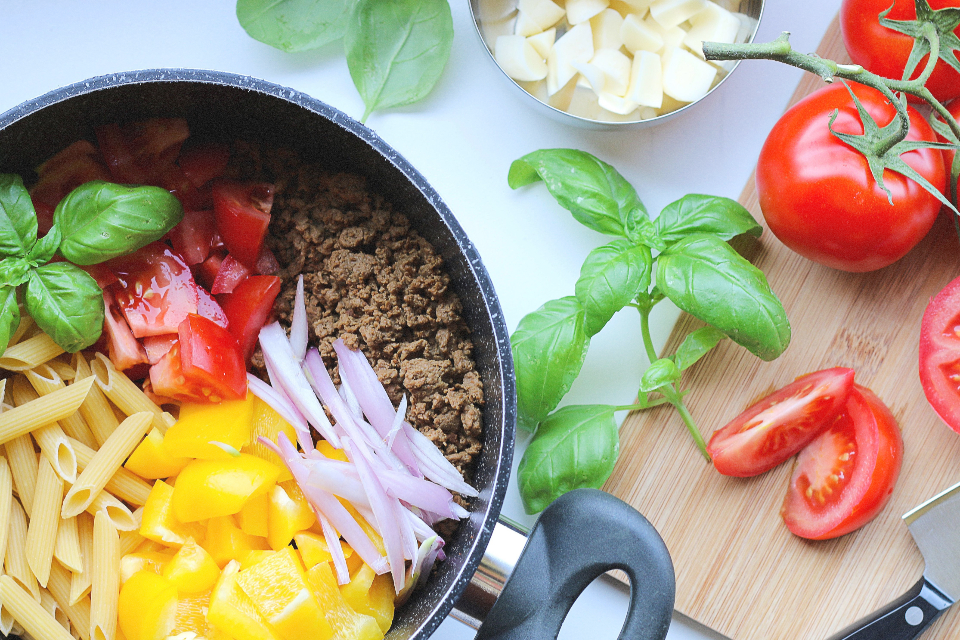

In [17]:
noise_removal_by_averaging(200, add_salt_noise)

# CONCLUSION: increasing the image count from 100 to 200 made it less noisy.

<a name="color-channels"></a>
## **Image Color Channels**

In [18]:
def show_channel(img, pos, mode):
  n, dims = get_image_dimensions(img)
  if n == 2:
    raise Exception('Image only has one channel. Utility function built for images with 3 channels.')
  
  x, y = dims[0], dims[1]

  mode_value = 0
  if mode == 'RGB':
    mode_value = 0
  elif mode == 'CMY':
    mode_value = 255
  else:
    raise Exception('Unidentified mode passed. Accepted modes are: "RGB", "CMY"')

  cimg = img.copy()

  if pos == 0:
    expr = '''cimg[i][j] = [cimg[i][j][pos], mode_value, mode_value]'''
  elif pos == 1:
    expr = '''cimg[i][j] = [mode_value, cimg[i][j][pos], mode_value]'''
  elif pos == 2:
    expr = '''cimg[i][j] = [mode_value, mode_value, cimg[i][j][pos]]'''

  for i in range(x):
    for j in range(y):
      exec(expr)

  show_image(cimg)

<a name="rgb"></a>
### **RGB (Red, Green, Blue)**

In [19]:
# RGB (Red, Green, Blue) channels

def show_red_channel(img):
  pos = 2
  mode = 'RGB'
  show_channel(img, pos=pos, mode=mode)


def show_green_channel(img):
  pos = 1
  mode = 'RGB'
  show_channel(img, pos=pos, mode=mode)


def show_blue_channel(img):
  pos = 0
  mode = 'RGB'
  show_channel(img, pos=pos, mode=mode)

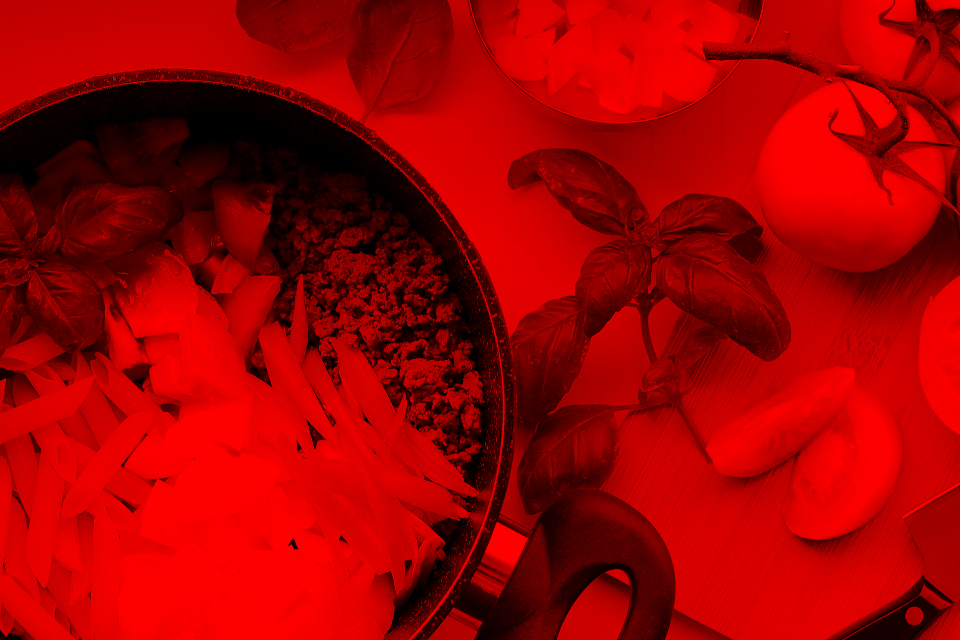

In [20]:
show_red_channel(img)

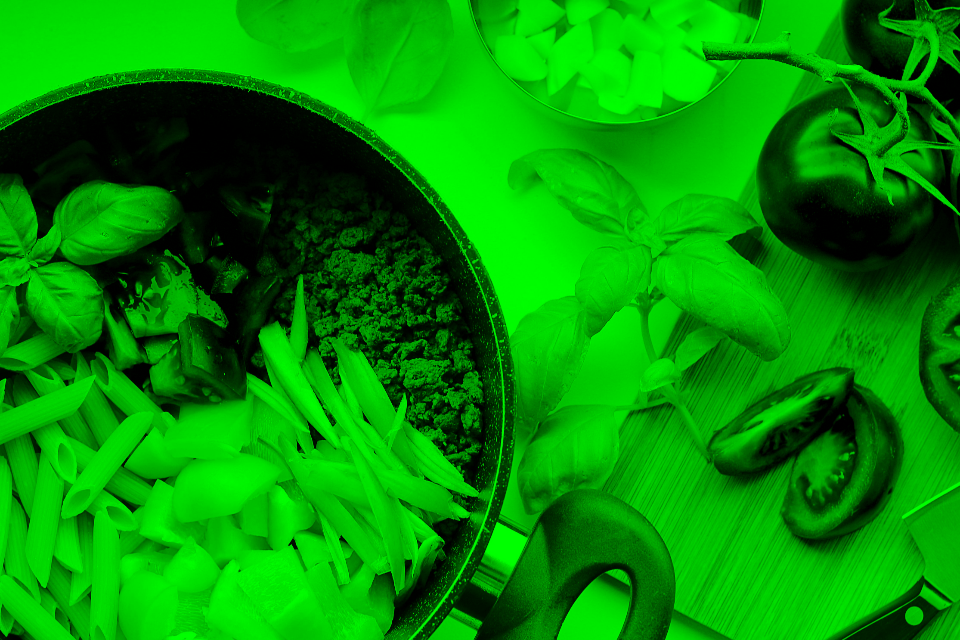

In [21]:
show_green_channel(img)

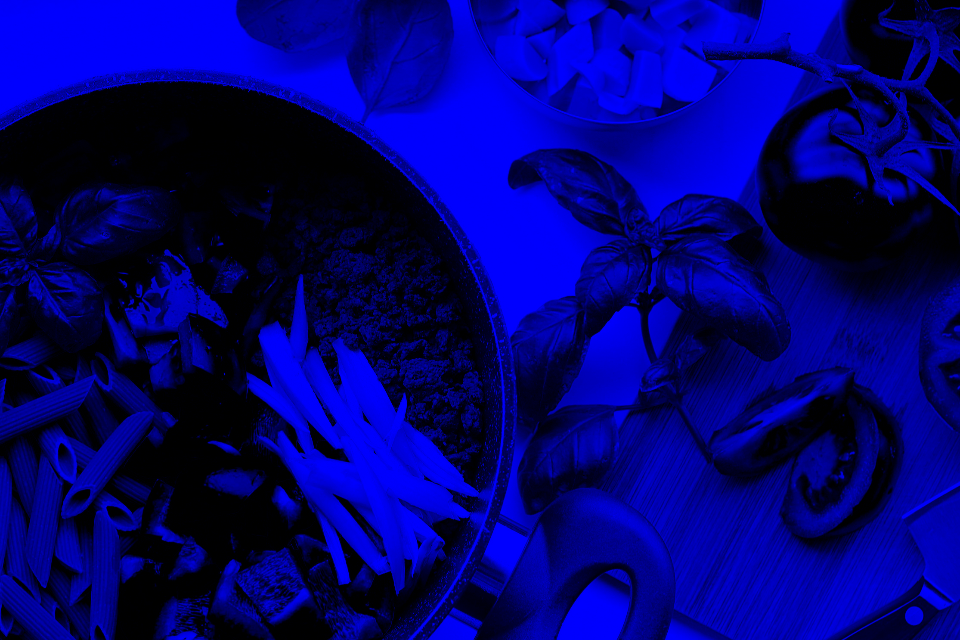

In [22]:
show_blue_channel(img)

<a name="cmy"></a>
### **CMY (Cyan, Magenta, Yellow)**

In [23]:
# CMY (Cyan, Magenta, Yellow) channels

def show_cyan_channel(img):
  pos = 2
  mode = 'CMY'
  show_channel(img, pos=pos, mode=mode)


def show_magenta_channel(img):
  pos = 1
  mode = 'CMY'
  show_channel(img, pos=pos, mode=mode)


def show_yellow_channel(img):
  pos = 0
  mode = 'CMY'
  show_channel(img, pos=pos, mode=mode)  

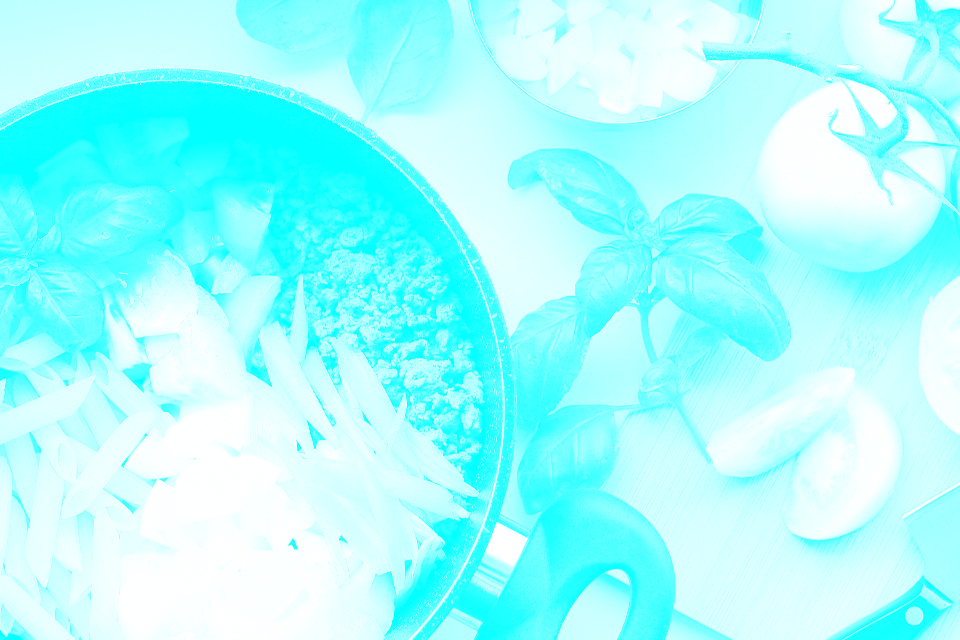

In [24]:
show_cyan_channel(img)

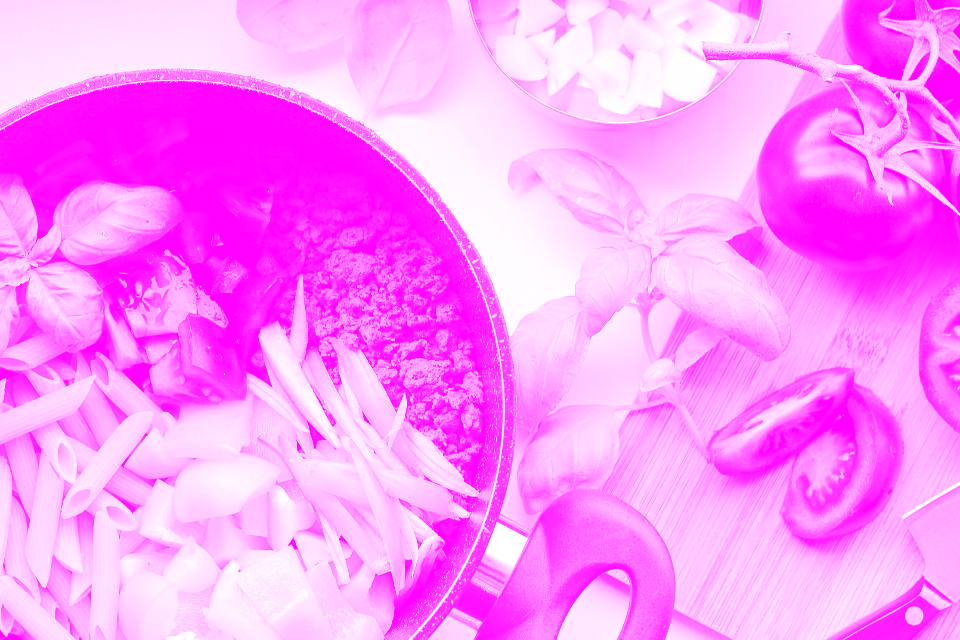

In [25]:
show_magenta_channel(img)

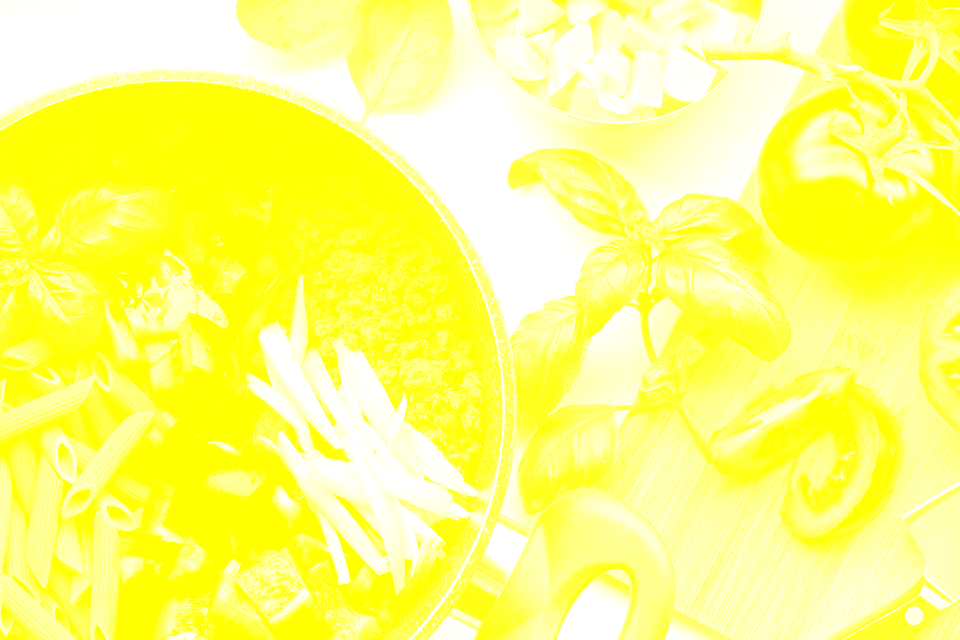

In [26]:
show_yellow_channel(img)

<a name="convolution"></a>
## **Image Convolution**


In [27]:
def get_padded_image(img, no_of_padding, padding_value=0):
  if no_of_padding < 0:
    raise Exception('WARNING: padding cannot be less than 0.')
  if no_of_padding == 0:
    return img
  
  x, y, z = 1, 1, 1
  n, dims = get_image_dimensions(img)
  if n == 2:
    x, y = dims[0], dims[1]
  elif n == 3:
    x, y, z = dims[0], dims[1], dims[2]

  limg = img.tolist()

  if n == 2:
    vertical_pad = [padding_value for i in range(y + no_of_padding*2)]

    for p in range(no_of_padding):
      for i in range(x):
        limg[i].insert(0, padding_value)
        limg[i].append(padding_value)
    
    for p in range(no_of_padding):
      limg.insert(0, vertical_pad)
      limg.append(vertical_pad)
  
  elif n == 3:
    vertical_pad = [[padding_value for i in range(z)] for i in range(y + no_of_padding*2)]

    for p in range(no_of_padding):
      for i in range(x):
        limg[i].insert(0, [padding_value for i in range(z)])
        limg[i].append([padding_value for i in range(z)])
    
    for p in range(no_of_padding):
      limg.insert(0, vertical_pad)
      limg.append(vertical_pad)

  return np.array(limg)

In [28]:
i = np.arange(11, 36)
i = i.reshape(5, 5)

padded_i = get_padded_image(i, no_of_padding=2, padding_value=999)
print(padded_i)
print()

padded_i = get_padded_image(i, no_of_padding=4)
print(padded_i)

[[999 999 999 999 999 999 999 999 999]
 [999 999 999 999 999 999 999 999 999]
 [999 999  11  12  13  14  15 999 999]
 [999 999  16  17  18  19  20 999 999]
 [999 999  21  22  23  24  25 999 999]
 [999 999  26  27  28  29  30 999 999]
 [999 999  31  32  33  34  35 999 999]
 [999 999 999 999 999 999 999 999 999]
 [999 999 999 999 999 999 999 999 999]]

[[ 0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 11 12 13 14 15  0  0  0  0]
 [ 0  0  0  0 16 17 18 19 20  0  0  0  0]
 [ 0  0  0  0 21 22 23 24 25  0  0  0  0]
 [ 0  0  0  0 26 27 28 29 30  0  0  0  0]
 [ 0  0  0  0 31 32 33 34 35  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0]]


In [52]:
im = np.arange(1, 26)
im = im.reshape(5, 5)
print('Image: ')
print(im)
print()


padding = 2
stride = 2

padded_img = get_padded_image(im, no_of_padding=padding, padding_value=0)
px, py = padded_img.shape
padded_pos_i = []

for i in range(px):
  padded_pos_i.append([])
  for j in range(py):
    padded_pos_i[i].append(f'({i},{j})')
print('Padded Image positional view:')
print(np.array(padded_pos_i))
print()

print('Padded Image: ')
print(padded_img)
print()


f = [
      [-1, -1, -1],
      [-1,  8, -1],
      [-1, -1, -1]
]
f = np.array(f)
print('Filter: ')
print(f)
print()


x, y = im.shape
fx, fy = f.shape

conv_pos_i = []
cx = math.floor((x + 2*padding - fx)/stride) + 1
cy = math.floor((y + 2*padding - fy)/stride) + 1
print('ConvImg dims: \t', cx, 'x', cy, '\n')


for i in range(cx):
  conv_pos_i.append([])
  for j in range(cy):
    conv_pos_i[i].append(f'({i},{j})')

print('Convolved Image positional view:')
print(np.array(conv_pos_i))

Image: 
[[ 1  2  3  4  5]
 [ 6  7  8  9 10]
 [11 12 13 14 15]
 [16 17 18 19 20]
 [21 22 23 24 25]]

Padded Image positional view:
[['(0,0)' '(0,1)' '(0,2)' '(0,3)' '(0,4)' '(0,5)' '(0,6)' '(0,7)' '(0,8)']
 ['(1,0)' '(1,1)' '(1,2)' '(1,3)' '(1,4)' '(1,5)' '(1,6)' '(1,7)' '(1,8)']
 ['(2,0)' '(2,1)' '(2,2)' '(2,3)' '(2,4)' '(2,5)' '(2,6)' '(2,7)' '(2,8)']
 ['(3,0)' '(3,1)' '(3,2)' '(3,3)' '(3,4)' '(3,5)' '(3,6)' '(3,7)' '(3,8)']
 ['(4,0)' '(4,1)' '(4,2)' '(4,3)' '(4,4)' '(4,5)' '(4,6)' '(4,7)' '(4,8)']
 ['(5,0)' '(5,1)' '(5,2)' '(5,3)' '(5,4)' '(5,5)' '(5,6)' '(5,7)' '(5,8)']
 ['(6,0)' '(6,1)' '(6,2)' '(6,3)' '(6,4)' '(6,5)' '(6,6)' '(6,7)' '(6,8)']
 ['(7,0)' '(7,1)' '(7,2)' '(7,3)' '(7,4)' '(7,5)' '(7,6)' '(7,7)' '(7,8)']
 ['(8,0)' '(8,1)' '(8,2)' '(8,3)' '(8,4)' '(8,5)' '(8,6)' '(8,7)' '(8,8)']]

Padded Image: 
[[ 0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0]
 [ 0  0  1  2  3  4  5  0  0]
 [ 0  0  6  7  8  9 10  0  0]
 [ 0  0 11 12 13 14 15  0  0]
 [ 0  0 16 17 18 19 20  0  0

In [50]:
def convolve_2D(img, filter, padding=0, stride=1):
  if stride < 1:
    raise Exception('WARNING: stride value must be minimum 1.')  


  fn, fdims = get_image_dimensions(filter)
  if fn > 2:
    raise Exception('WARNING: convolve_2D() function only convolves 2D images with 2D filters.')
  
  fx, fy = fdims[0], fdims[1]


  n, dims = get_image_dimensions(img)
  
  if n == 3:
    raise Exception('WARNING: convolve_2D() function only convolves 2D images with 2D filters.')
  elif n > 3:
    raise Exception('WARNING: unsupported dimensions. convolve() can only convolve 2D or 3D images')
  
  x, y = dims[0], dims[1]


  padded_img = get_padded_image(img, no_of_padding=padding, padding_value=0)
  pn, pdims = get_image_dimensions(padded_img)
  px, py = pdims[0], pdims[1]

  
  convolved_img = []
  cx = math.floor((x + 2*padding - fx)/stride) + 1
  cy = math.floor((y + 2*padding - fy)/stride) + 1

  conv_values = []
  f_cells = fx * fy

  for pi in range(0, (px - fx + 1), stride):
    for pj in range(0, (py - fy + 1), stride):
      sum = 0

      for fi in range(fx):
        for fj in range(fy):
          sum += padded_img[pi+fi][pj+fj] * filter[fi][fj]
      
      conv_values.append(round_to_int(sum / f_cells))

  if len(conv_values) != cx * cy:
    raise Exception('WARNING: dimensional problems occurred!')

  conv_val_stack = conv_values.copy()
  conv_val_stack.reverse()
  for i in range(cx):
    convolved_img.append([])
    for j in range(cy):
      convolved_img[i].append(conv_val_stack.pop())


  print('Stride size: \t', stride)
  print('Padding size: \t', padding)
  print('Filter dims: \t', fx, 'x', fy)
  print('Image dims: \t', x, 'x', y)
  print('ConvImg dims: \t', cx, 'x', cy)
  print()
  return np.array(convolved_img)

In [49]:
def convolve(img, filter, padding=0, stride=1):
  if stride < 1:
    raise Exception('WARNING: stride value must be minimum 1.')  


  fn, fdims = get_image_dimensions(filter)
  if fn > 2:
    raise Exception('WARNING: convolve() function only convolves 2D or 3D images with 2D filters.')
  
  fx, fy = fdims[0], fdims[1]
  

  n, dims = get_image_dimensions(img)
  x, y, z = 1, 1, 1

  if n == 2:
    return convolve_2D(img, filter, padding, stride)
  elif n == 3:
    x, y, z = dims[0], dims[1], dims[2]
  else:
    raise Exception('WARNING: unsupported dimensions. convolve() can only convolve 2D or 3D images')
  

  padded_img = get_padded_image(img, no_of_padding=padding, padding_value=0)
  pn, pdims = get_image_dimensions(padded_img)
  px, py, pz = pdims[0], pdims[1], pdims[2]

  
  convolved_img = []
  cx = math.floor((x + 2*padding - fx)/stride) + 1
  cy = math.floor((y + 2*padding - fy)/stride) + 1
  cz = z

  conv_values = []
  f_cells = fx * fy
  
  for pi in range(0, (px - fx + 1), stride):
    for pj in range(0, (py - fy + 1), stride):
      sums = [0 for i in range(z)]

      for fi in range(fx):
        for fj in range(fy):
          for k in range(z):
            sums[k] += padded_img[pi+fi][pj+fj][k] * filter[fi][fj]
      
      avg_sums = [round_to_int(i/f_cells) for i in sums]
      # conv_values.append(round_to_int(sum(avg_sums) / z))
      conv_values.append(avg_sums)

  if len(conv_values) != cx * cy:
    raise Exception('WARNING: dimensional problems occurred!')

  conv_val_stack = conv_values.copy()
  conv_val_stack.reverse()
  for i in range(cx):
    convolved_img.append([])
    for j in range(cy):
      convolved_img[i].append(conv_val_stack.pop())


  print('Stride size: \t', stride)
  print('Padding size: \t', padding)
  print('Filter dims: \t', fx, 'x', fy)
  print('Image dims: \t', x, 'x', y, 'x', z)
  print('ConvImg dims: \t', cx, 'x', cy, 'x', cz)
  print()
  return np.array(convolved_img)

In [51]:
i = [
     [ 1,  2,  3,  4,  5],
     [ 6,  7,  8,  9, 10],
     [11, 12, 13, 14, 15],
     [16, 17, 18, 19, 20],
     [21, 22, 23, 24, 25]
]
i = np.array(i)

f = [
      [-1, -1, -1],
      [-1,  8, -1],
      [-1, -1, -1]
]
f = np.array(f)

test1 = convolve_2D(i, f, stride=2, padding=3)
print()
test2 = convolve(img, f, stride=1, padding=1)

Stride size: 	 2
Padding size: 	 3
Filter dims: 	 3 x 3
Image dims: 	 5 x 5
ConvImg dims: 	 5 x 5


Stride size: 	 1
Padding size: 	 1
Filter dims: 	 3 x 3
Image dims: 	 640 x 960 x 3
ConvImg dims: 	 640 x 960 x 3



Values after 2D convolution:
[[ 0  0  0  0  0]
 [ 0  0  0  2  0]
 [ 0  3  0  5  0]
 [ 0 13  9 15  0]
 [ 0  0  0  0  0]]

Masked Image after 3D convolution:


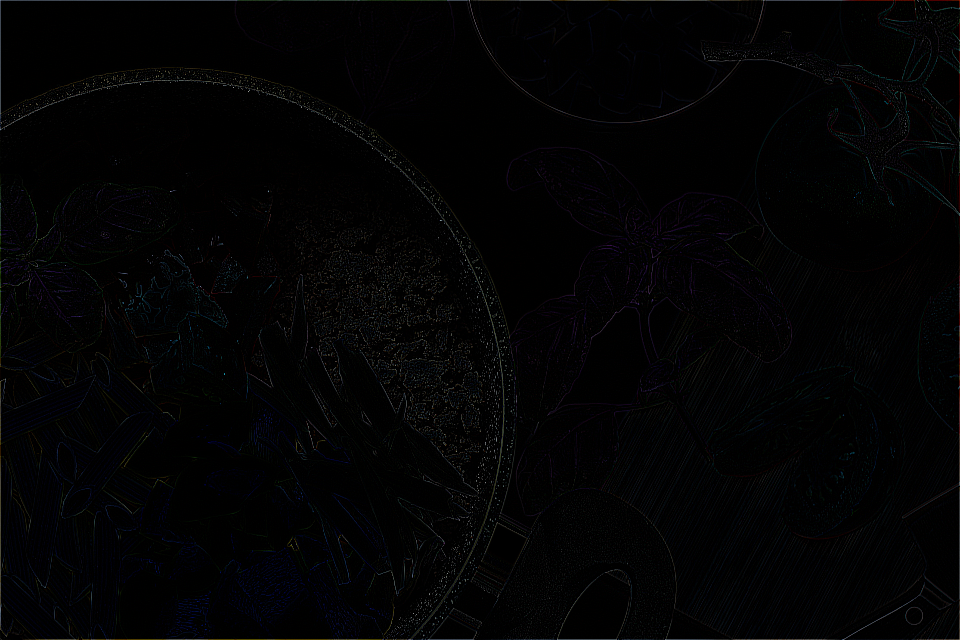

In [54]:
print('Values after 2D convolution:')
print(test1)
print()

print('Masked Image after 3D convolution:')
show_image(test2)

<a name="laplace-sharp"></a>
## **Laplacian Sharpening**

In [59]:
def get_laplacian_filter(mode='POS8'):
  filter = []

  if mode == 'POS2':
    filter = [
            [0, -1, 0],
            [0,  2, 0],
            [0, -1, 0]
    ]
  elif mode == 'POS4':
    filter = [
            [ 0, -1,  0],
            [-1,  4, -1],
            [ 0, -1,  0]
    ]
  elif mode == 'POS8':
    filter = [
            [-1, -1, -1],
            [-1,  8, -1],
            [-1, -1, -1]
    ]
  

  elif mode == 'NEG2':
    filter = [
            [0,  1, 0],
            [0, -2, 0],
            [0,  1, 0]
    ]
  elif mode == 'NEG4':
    filter = [
            [0,  1, 0],
            [1, -4, 1],
            [0,  1, 0]
    ]
  elif mode == 'NEG8':
    filter = [
            [1,  1, 1],
            [1, -8, 1],
            [1,  1, 1]
    ]
  else:
    raise Exception('Incorrect laplacian filter mode provided.')

  return np.array(filter)

In [34]:
get_laplacian_filter()

array([[-1, -1, -1],
       [-1,  8, -1],
       [-1, -1, -1]])

In [35]:
get_laplacian_filter('NEG4')

array([[ 0,  1,  0],
       [ 1, -4,  1],
       [ 0,  1,  0]])

Stride size: 	 1
Padding size: 	 1
Filter dims: 	 3 x 3
Image dims: 	 640 x 960 x 3
ConvImg dims: 	 640 x 960 x 3



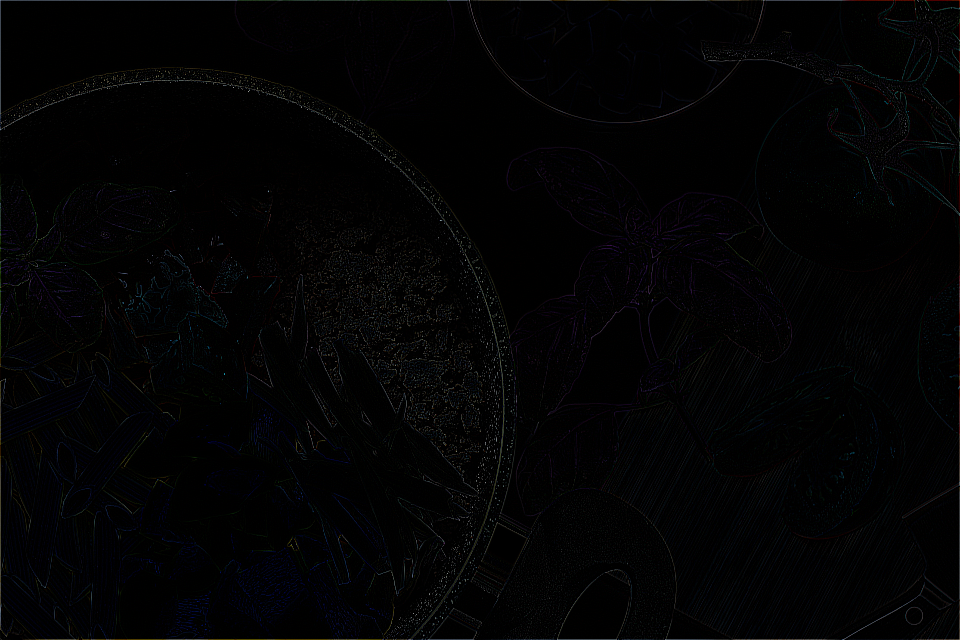

In [55]:
filter = get_laplacian_filter('POS8')
convolved_img = convolve(img, filter, padding=1)

show_image(convolved_img)

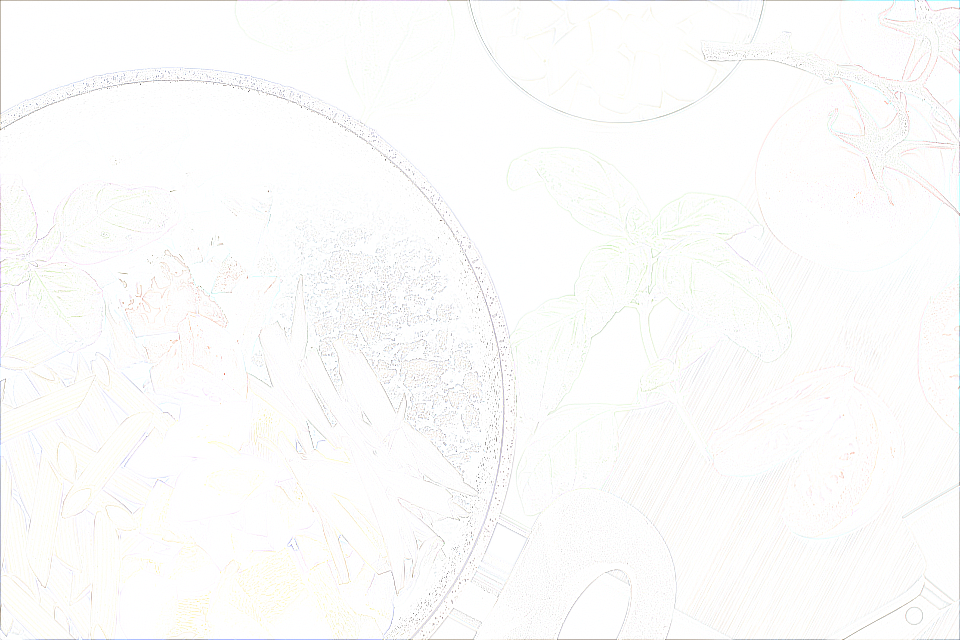

In [56]:
show_image(255 - convolved_img)

Stride size: 	 1
Padding size: 	 1
Filter dims: 	 3 x 3
Image dims: 	 640 x 960
ConvImg dims: 	 640 x 960



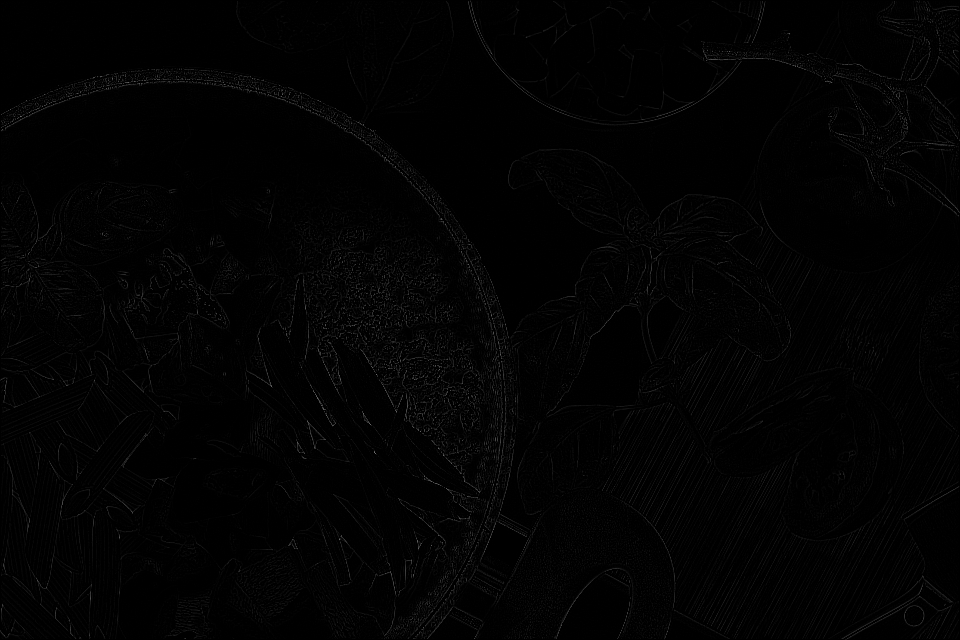

In [57]:
bw_img = get_grayscale(img)
filter = get_laplacian_filter('NEG8')

bw_convolved_img = convolve_2D(bw_img, filter, padding=1)
show_image(bw_convolved_img)

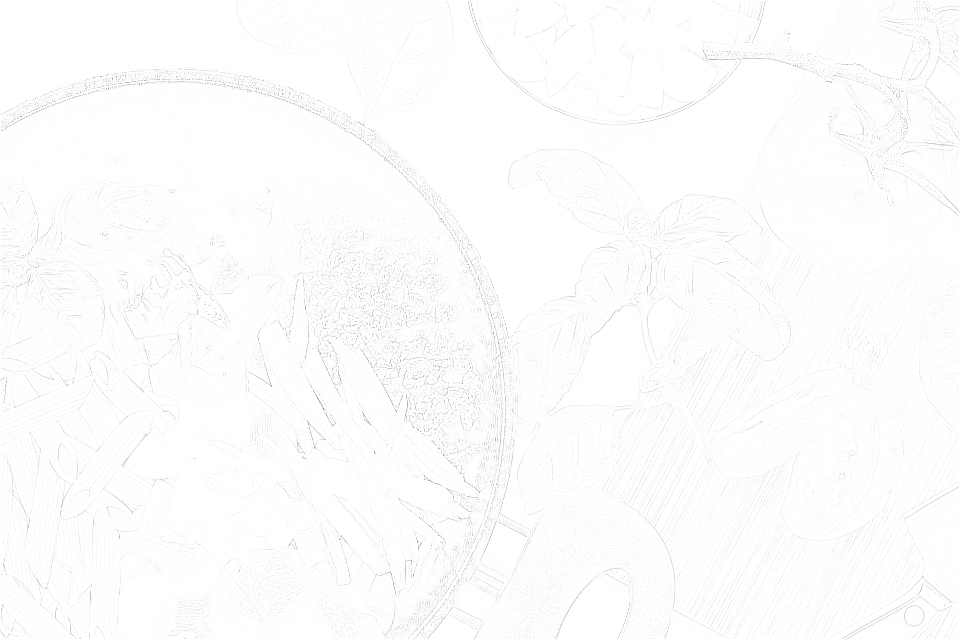

In [58]:
show_image(255 - bw_convolved_img)

In [62]:
def laplacian_sharpen(img, laplacian_filter_type='POS8', multiplier=1):
  laplacian_filter = get_laplacian_filter(laplacian_filter_type)
  
  n, dims = get_image_dimensions(img)
  
  masked_image = []
  if n == 2:
    masked_image = convolve_2D(img, laplacian_filter, padding=1, stride=1)
  else:
    masked_image = convolve(img, laplacian_filter, padding=1, stride=1)
  
  sign = 1
  if 'NEG' in laplacian_filter_type:
    sign = -1

  return img + (sign * (multiplier * masked_image))
  

In [70]:
sharpened_img = laplacian_sharpen(img)

Stride size: 	 1
Padding size: 	 1
Filter dims: 	 3 x 3
Image dims: 	 640 x 960 x 3
ConvImg dims: 	 640 x 960 x 3



Original Image:


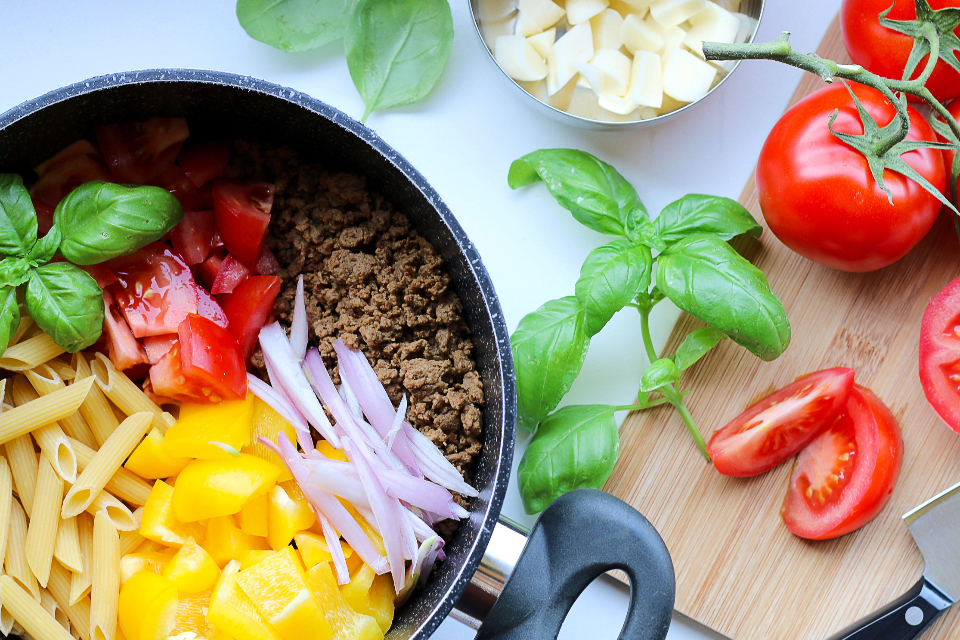

In [71]:
print('Original Image:')
show_image(img)

Sharpened Image:


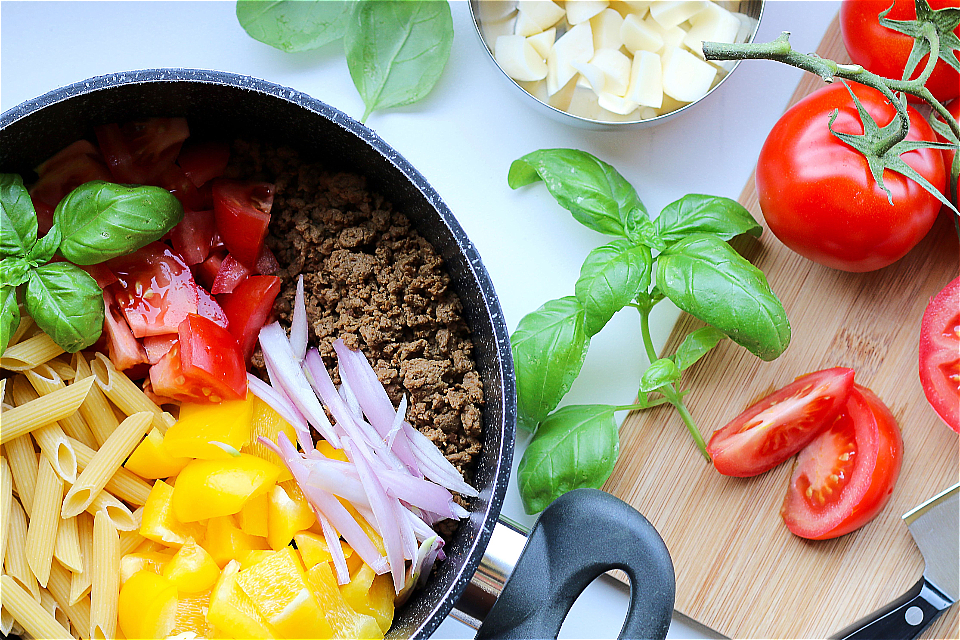

In [72]:
print('Sharpened Image:')
show_image(sharpened_img)

Stride size: 	 1
Padding size: 	 1
Filter dims: 	 3 x 3
Image dims: 	 640 x 960
ConvImg dims: 	 640 x 960

Original Black & White Image:


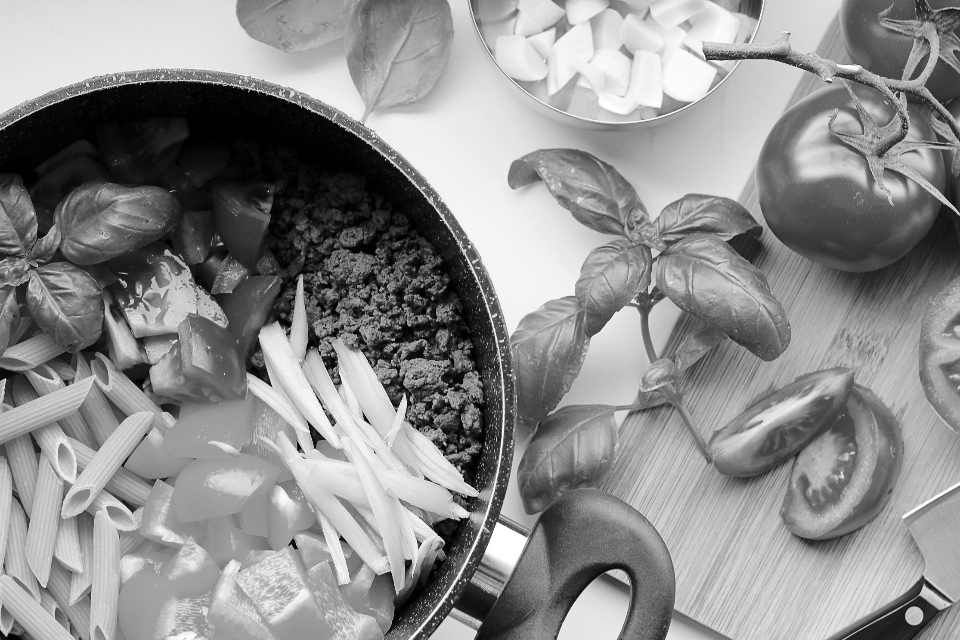


VS.

Sharpened Black & White Image:


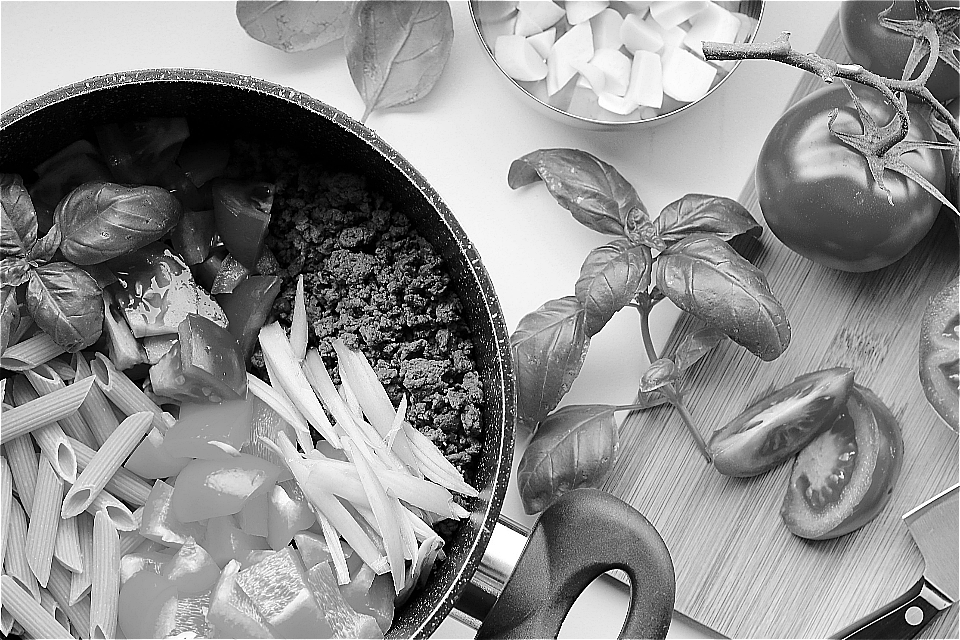

In [68]:
sharpened_bw_img = laplacian_sharpen(bw_img, laplacian_filter_type='NEG8', multiplier=2)

print('Original Black & White Image:')
show_image(bw_img)

print('\n' + 'VS.' + '\n')

print('Sharpened Black & White Image:')
show_image(sharpened_bw_img)

## **Image Equalization**